# TTS Video Project Pipeline
This notebook covers all steps from input text, TTS voice synthesis, subtitle generation, audio/video concatenation, image processing, and final export for YouTube.

In [4]:
!pip install azure-cognitiveservices-speech pysubs2 pillow snownlp python-dotenv tqdm pyyaml


[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [41]:
import os
import yaml
from dotenv import load_dotenv

# Set main working directory
main_dir = r"C:\Users\flyre\mynotebooks"
os.chdir(main_dir)
subdir = main_dir

# Load environment variables
load_dotenv()
AZURE_SPEECH_KEY = os.environ.get("AZURE_SPEECH_KEY")
AZURE_SPEECH_REGION = os.environ.get("AZURE_SPEECH_REGION")
MINIMAX_SPEECH_KEY = os.environ.get("MINIMAX_SPEECH_KEY")
if not AZURE_SPEECH_KEY or not AZURE_SPEECH_REGION or not MINIMAX_SPEECH_KEY:
    raise ValueError("Missing AZURE_SPEECH_KEY or AZURE_SPEECH_REGION or MINIMAX_SPEECH_KEY in .env file!")

# Load config.yaml if it exists, otherwise use empty config
if os.path.exists('config.yaml'):
    with open('config.yaml', encoding='utf-8') as f:
        config = yaml.safe_load(f)
else:
    config = {}

print("="*40)
print(f"專案名稱: {config.get('project_title', config.get('title', '未設定'))}")
print(f"Current subdir: {subdir}")
print(f"目前工作目錄：{os.getcwd()}")
print("="*40)

專案名稱: 早安
Current subdir: C:\Users\flyre\mynotebooks
目前工作目錄：C:\Users\flyre\mynotebooks


In [42]:
# cell 3
print("專案名稱:", config.get("project_title", config.get("title", "未設定")))
print("Current subdir:", subdir)
print("目前工作目錄：", os.getcwd())

import ipywidgets as widgets
from IPython.display import display, clear_output, Audio
import yaml
import os
from dotenv import load_dotenv
import requests
import tempfile

load_dotenv()

label_style = {'description_width': '120px'}
wide_layout = widgets.Layout(width='1100px')
wide_textarea_layout = widgets.Layout(width='1100px', height='250px')
wide_preview_textarea_layout = widgets.Layout(width='1100px', height='125px')

# Azure voices
azure_voice_options = [
    'zh-TW-YunJheNeural', 'zh-TW-HsiaoChenNeural', 'zh-CN-YunxiNeural',
    'en-US-JennyNeural', 'en-US-AriaNeural', 'en-US-GuyNeural',
    'ja-JP-NanamiNeural', 'ja-JP-KeitaNeural'
]

# MINIMAX accents and voices
minimax_accent_options = [
    ('中文-普通話', 'Chinese (Mandarin)'),
    ('英文', 'English'),
    ('日文', 'Japanese')
]
minimax_voice_dict = {
    'Chinese (Mandarin)': [
        'Chinese (Mandarin)_Warm_Bestie',
        'Chinese (Mandarin)_Lyrical_Voice',
        'Chinese (Mandarin)_Bright_Light',
        'Chinese (Mandarin)_Sweet_Girl',
        'Chinese (Mandarin)_Young_Man',
        'Chinese (Mandarin)_Deep_Dad',
        'Chinese (Mandarin)_Calm_Mom',
        'Chinese (Mandarin)_Narrator_Professional',
        'Chinese (Mandarin)_Narrator_Soft',
        'Chinese (Mandarin)_Child_Boy',
        'Chinese (Mandarin)_Child_Girl',
        'Chinese (Mandarin)_Elder_Grandpa',
        'Chinese (Mandarin)_Elder_Grandma',
        'Chinese (Mandarin)_News_Anchor',
        'Chinese (Mandarin)_Cartoon_Bear',
        'Chinese (Mandarin)_Cartoon_Duck',
        'Chinese (Mandarin)_Cartoon_Fox',
        'Chinese (Mandarin)_Cartoon_Robot'
    ],
    'English': [
        'English_Graceful_Lady',
        'English_Persuasive_Man'
    ],
    'Japanese': [
        'Japanese_Whisper_Belle'
    ]
}

# Input widgets
input_text_widget = widgets.Textarea(
    value='', description='文字內容:', style=label_style, layout=wide_textarea_layout
)
preview_text_widget = widgets.Textarea(
    value='', description='試聽文字:', style=label_style, layout=wide_preview_textarea_layout
)
preview_button = widgets.Button(description='語音試聽', button_style='info', layout=widgets.Layout(width='350px', height='60px'))
audio_output = widgets.Output(layout=wide_layout)
save_button = widgets.Button(description='確定儲存', button_style='success', layout=widgets.Layout(width='350px', height='60px'))
output = widgets.Output(layout=wide_layout)

tts_server_widget = widgets.Dropdown(
    options=[('Azure', 'azure'), ('MINIMAX', 'minimax')],
    value='azure', description='TTS伺服器:', style=label_style, layout=wide_layout
)

# Azure widgets
azure_voice_widget = widgets.Dropdown(
    options=azure_voice_options, value=azure_voice_options[0],
    description='Azure語音:', style=label_style, layout=wide_layout
)
azure_speed_widget = widgets.FloatSlider(value=1.0, min=0.5, max=2.0, step=0.01, description='語速:', style=label_style, layout=wide_layout)
azure_pitch_widget = widgets.IntSlider(value=0, min=-12, max=12, step=1, description='語調:', style=label_style, layout=wide_layout)

# MINIMAX widgets
minimax_model_widget = widgets.Dropdown(
    options=['speech-02-hd', 'speech-2.5-hd-preview'], value='speech-02-hd', description='MINIMAX模型:', style=label_style, layout=wide_layout)
minimax_accent_widget = widgets.Dropdown(
    options=minimax_accent_options, value='Chinese (Mandarin)', description='MINIMAX腔調:', style=label_style, layout=wide_layout
)
minimax_voice_widget = widgets.Dropdown(
    options=minimax_voice_dict['Chinese (Mandarin)'], value=minimax_voice_dict['Chinese (Mandarin)'][0],
    description='MINIMAX語音:', style=label_style, layout=wide_layout
)
minimax_emotion_widget = widgets.Dropdown(
    options=['calm', 'happy', 'sad', 'angry', 'fearful', 'disgusted', 'surprised'],
    value='calm', description='MINIMAX情感:', style=label_style, layout=wide_layout)
minimax_vol_widget = widgets.FloatSlider(value=1.0, min=0.1, max=10.0, step=0.1, description='MINIMAX音量:', style=label_style, layout=wide_layout)
minimax_speed_widget = widgets.FloatSlider(value=1.0, min=0.5, max=2.0, step=0.01, description='語速:', style=label_style, layout=wide_layout)
minimax_pitch_widget = widgets.IntSlider(value=0, min=-12, max=12, step=1, description='語調:', style=label_style, layout=wide_layout)
minimax_audio_format_widget = widgets.Dropdown(
    options=['mp3', 'wav'], value='mp3', description='MINIMAX音檔格式:', style=label_style, layout=wide_layout)
minimax_sample_rate_widget = widgets.Dropdown(
    options=[32000, 44100], value=32000, description='MINIMAX取樣率:', style=label_style, layout=wide_layout)
minimax_bitrate_widget = widgets.Dropdown(
    options=[128000, 256000], value=128000, description='MINIMAX比特率:', style=label_style, layout=wide_layout)
minimax_channel_widget = widgets.Dropdown(
    options=[1, 2], value=1, description='MINIMAX聲道:', style=label_style, layout=wide_layout)

# Accent change updates voice list
def update_minimax_voices(*args):
    accent = minimax_accent_widget.value
    minimax_voice_widget.options = minimax_voice_dict[accent]
    minimax_voice_widget.value = minimax_voice_dict[accent][0]
minimax_accent_widget.observe(update_minimax_voices, names='value')

# --- Project info widgets ---
project_title_widget = widgets.Text(value='test', description='專案名稱:', style=label_style, layout=wide_layout)
project_author_widget = widgets.Text(value='', description='作者:', style=label_style, layout=wide_layout)
bgm_volume_widget = widgets.FloatSlider(value=0.3, min=0, max=1, step=0.01, description='BGM音量:', style=label_style, layout=wide_layout)
attribution_widget = widgets.Text(value='', description='版權說明:', style=label_style, layout=wide_layout)
subtitle_font_widget = widgets.Text(value='NotoSansCJKtc-Regular.otf', description='字幕字型:', style=label_style, layout=wide_layout)
subtitle_fontsize_widget = widgets.IntSlider(value=30, min=10, max=80, step=1, description='字幕字體大小:', style=label_style, layout=wide_layout)
video_resolution_widget = widgets.Text(value='1920,1080', description='影片解析度:', style=label_style, layout=wide_layout)

# --- Dynamically list images and audio from ammunition directory ---
def get_ammunition_files(extension_list):
    files = []
    if os.path.isdir("ammunition"):
        for fname in os.listdir("ammunition"):
            if any(fname.lower().endswith(ext) for ext in extension_list):
                files.append(fname)
    return files if files else ["(無符合檔案)"]

background_image_options = get_ammunition_files(['.jpg', '.jpeg', '.png', '.bmp', '.webp'])
bgm_audio_options = get_ammunition_files(['.mp3', '.wav', '.aac', '.m4a', '.flac', '.ogg'])

background_file_widget = widgets.Dropdown(
    options=background_image_options,
    value=background_image_options[0],
    description='背景檔:', style=label_style, layout=wide_layout
)
bgm_file_widget = widgets.Dropdown(
    options=bgm_audio_options,
    value=bgm_audio_options[0],
    description='BGM檔:', style=label_style, layout=wide_layout
)

thumbnail_file_widget = widgets.Text(value='thumbnail.jpg', description='縮圖檔:', style=label_style, layout=wide_layout)
text_file_widget = widgets.Text(value='text.txt', description='文字檔:', style=label_style, layout=wide_layout)

project_info_box = widgets.VBox([
    project_title_widget, project_author_widget, bgm_volume_widget,
    attribution_widget, subtitle_font_widget, subtitle_fontsize_widget,
    video_resolution_widget, background_file_widget, bgm_file_widget,
    thumbnail_file_widget, text_file_widget
])

# --- Dynamic param box ---
param_box = widgets.VBox()
def update_param_box(*args):
    if tts_server_widget.value == 'azure':
        param_box.children = [azure_voice_widget, azure_speed_widget, azure_pitch_widget]
    else:
        param_box.children = [
            minimax_model_widget, minimax_accent_widget, minimax_voice_widget, minimax_emotion_widget,
            minimax_vol_widget, minimax_speed_widget, minimax_pitch_widget,
            minimax_audio_format_widget, minimax_sample_rate_widget, minimax_bitrate_widget, minimax_channel_widget
        ]
update_param_box()
tts_server_widget.observe(update_param_box, names='value')

# ---- TTS Functions ----
def azure_tts_api(text, voice, speed, pitch):
    AZURE_SPEECH_KEY = os.environ.get("AZURE_SPEECH_KEY")
    AZURE_SPEECH_REGION = os.environ.get("AZURE_SPEECH_REGION")
    if not AZURE_SPEECH_KEY or not AZURE_SPEECH_REGION:
        print("Azure API key 或 region 未設定。")
        return None
    try:
        import azure.cognitiveservices.speech as speechsdk
        speech_config = speechsdk.SpeechConfig(subscription=AZURE_SPEECH_KEY, region=AZURE_SPEECH_REGION)
        speech_config.speech_synthesis_voice_name = voice
        synthesizer = speechsdk.SpeechSynthesizer(speech_config=speech_config)
        result = synthesizer.speak_text_async(text).get()
        if result.reason == speechsdk.ResultReason.Canceled:
            cancellation_details = speechsdk.CancellationDetails(result)
            print(f"Azure TTS失敗: {cancellation_details.reason}\n{cancellation_details.error_details}")
            return None
        if result.reason == speechsdk.ResultReason.SynthesizingAudioCompleted:
            tf = tempfile.NamedTemporaryFile(delete=False, suffix='.wav')
            tf.write(result.audio_data)
            tf.close()
            return tf.name
        else:
            print(f"Azure TTS失敗: {getattr(result, 'error_details', str(result.reason))}")
    except Exception as e:
        print("Azure TTS執行錯誤:", str(e))
    return None

def minimax_tts_api(text, model, voice, emotion, vol, speed, pitch, audio_format, sample_rate, bitrate, channel):
    MINIMAX_SPEECH_KEY = os.getenv('MINIMAX_SPEECH_KEY')
    url = f"https://api.minimax.io/v1/t2a_v2?GroupId=1982992498867311582"
    headers = {
        "Authorization": f"Bearer {MINIMAX_SPEECH_KEY}",
        "Content-Type": "application/json"
    }
    payload = {
        "model": model,
        "text": text,
        "voice_setting": {
            "voice_id": voice,
            "speed": speed,
            "vol": vol,
            "pitch": pitch,
            "emotion": emotion
        },
        "audio_setting": {
            "sample_rate": sample_rate,
            "bitrate": bitrate,
            "format": audio_format,
            "channel": channel
        },
        "output_format": "url",
        "language_boost": "auto",
        "subtitle_enable": False
    }
    try:
        r = requests.post(url, headers=headers, json=payload)
        if r.status_code == 200:
            data = r.json()
            base_resp = data.get("base_resp", {})
            if base_resp.get("status_code") == 0:
                audio_url = data.get("data", {}).get("audio")
                if audio_url:
                    r2 = requests.get(audio_url)
                    if r2.status_code == 200:
                        with tempfile.NamedTemporaryFile(delete=False, suffix='.'+audio_format) as tf:
                            tf.write(r2.content)
                            temp_audio_path = tf.name
                        return temp_audio_path
                    else:
                        print("MINIMAX音檔下載失敗：", r2.status_code)
                else:
                    print("MINIMAX未取得音檔URL，請檢查API回應！")
            else:
                print("MINIMAX API錯誤：", base_resp.get("status_msg"))
        else:
            print("MINIMAX TTS API失敗，狀態碼：", r.status_code)
            print("回應：", r.text[:300])
            print("Payload used:\n", payload)
    except Exception as e:
        print("MINIMAX TTS試聽錯誤：", e)
    return None

def on_preview_clicked(b):
    with audio_output:
        audio_output.clear_output()
        preview_text = preview_text_widget.value.strip()
        if not preview_text:
            print("請輸入欲試聽的語音文字！")
            return
        if tts_server_widget.value == 'azure':
            temp_audio_path = azure_tts_api(
                preview_text, azure_voice_widget.value, azure_speed_widget.value, azure_pitch_widget.value)
        else:
            temp_audio_path = minimax_tts_api(
                preview_text, minimax_model_widget.value, minimax_voice_widget.value,
                minimax_emotion_widget.value, minimax_vol_widget.value,
                minimax_speed_widget.value, minimax_pitch_widget.value,
                minimax_audio_format_widget.value, minimax_sample_rate_widget.value,
                minimax_bitrate_widget.value, minimax_channel_widget.value)
        if temp_audio_path:
            display(Audio(temp_audio_path, autoplay=True))
            print(f"{tts_server_widget.value}語音試聽成功！")

preview_button.on_click(on_preview_clicked)

def on_save_clicked(b):
    # Enforce project_title is not empty
    project_title_value = project_title_widget.value.strip() if project_title_widget.value.strip() else "test"
    project_title_widget.value = project_title_value  # update widget if needed

    config = {
        'input_text': input_text_widget.value,
        'preview_text': preview_text_widget.value,
        'tts_server': tts_server_widget.value,
        'azure_voice': azure_voice_widget.value,
        'azure_speed': azure_speed_widget.value,
        'azure_pitch': azure_pitch_widget.value,
        'minimax_model': minimax_model_widget.value,
        'minimax_accent': minimax_accent_widget.value,
        'minimax_voice': minimax_voice_widget.value,
        'minimax_emotion': minimax_emotion_widget.value,
        'minimax_vol': minimax_vol_widget.value,
        'minimax_speed': minimax_speed_widget.value,
        'minimax_pitch': minimax_pitch_widget.value,
        'minimax_audio_format': minimax_audio_format_widget.value,
        'minimax_sample_rate': minimax_sample_rate_widget.value,
        'minimax_bitrate': minimax_bitrate_widget.value,
        'minimax_channel': minimax_channel_widget.value,
        'project_title': project_title_value,
        'project_author': project_author_widget.value,
        'bgm_volume': bgm_volume_widget.value,
        'attribution': attribution_widget.value,
        'subtitle_font': subtitle_font_widget.value,
        'subtitle_fontsize': subtitle_fontsize_widget.value,
        'video_resolution': video_resolution_widget.value,
        'background': background_file_widget.value,
        'bgm': bgm_file_widget.value,
        'thumbnail': thumbnail_file_widget.value,
        'text': text_file_widget.value,
    }
    with output:
        output.clear_output()
        # 儲存 config.yaml
        yaml.safe_dump(config, open('config.yaml', 'w', encoding='utf-8'), allow_unicode=True)
        # 同步寫入 text.txt
        try:
            with open(text_file_widget.value, 'w', encoding='utf-8') as f:
                f.write(input_text_widget.value)
            print('設定已儲存到 config.yaml，且文字內容已同步寫入 text.txt！')
        except Exception as e:
            print(f"[ERROR] 寫入 text.txt 失敗：{e}")
        print(config)
        if project_title_value == "test":
            print("⚠️ 專案名稱為 test，請在專案開始前確認填寫正確名稱。")

save_button.on_click(on_save_clicked)

# ---- Display all widgets ----
display(
    input_text_widget,
    preview_text_widget,
    preview_button,
    audio_output,
    tts_server_widget,
    param_box,
    project_info_box,
    save_button,
    output
)
print("="*40)
print(f"專案名稱: {project_title}")
print(f"Current subdir: {subdir}")
print(f"目前工作目錄：{os.getcwd()}")
print("="*40)

專案名稱: 早安
Current subdir: C:\Users\flyre\mynotebooks
目前工作目錄： C:\Users\flyre\mynotebooks


Textarea(value='', description='文字內容:', layout=Layout(height='250px', width='1100px'), style=TextStyle(descrip…

Textarea(value='', description='試聽文字:', layout=Layout(height='125px', width='1100px'), style=TextStyle(descrip…

Button(button_style='info', description='語音試聽', layout=Layout(height='60px', width='350px'), style=ButtonStyle…

Output(layout=Layout(width='1100px'))

Dropdown(description='TTS伺服器:', layout=Layout(width='1100px'), options=(('Azure', 'azure'), ('MINIMAX', 'minim…

Button(button_style='success', description='確定儲存', layout=Layout(height='60px', width='350px'), style=ButtonSt…

Output(layout=Layout(width='1100px'))

專案名稱: 缺頁小說
Current subdir: C:\Users\flyre\mynotebooks
目前工作目錄：C:\Users\flyre\mynotebooks


In [43]:
#cell 4-8

import os
import yaml
import shutil
import datetime
import re
from snownlp import SnowNLP
import subprocess
from tqdm.notebook import tqdm
from dotenv import load_dotenv

print("=== STEP 0: 專案資料 ===")
main_dir = os.getcwd()
ammunition_dir = os.path.join(main_dir, "ammunition")
print("Current subdir:", main_dir)
print("目前工作目錄：", os.getcwd())
print("資源目錄(ammunition):", ammunition_dir)

print("\n=== STEP 1: 讀取 config 及同步更新 text.txt ===")
# ---- Load config ----
try:
    with open('config.yaml', encoding='utf-8') as f:
        config = yaml.safe_load(f)
except Exception as e:
    print(f"[ERROR] Failed to load config.yaml: {e}")
    raise

project_title = config.get('project_title', config.get('title', 'My YouTube Video'))
project_author = config.get('project_author', 'Anonymous')
bgm_volume = config.get('bgm_volume', 0.3)
attribution = config.get('attribution', 'Assets used under free license. See description.')

background_file = os.path.join(ammunition_dir, config.get('background', 'background.jpg'))
bgm_file = os.path.join(ammunition_dir, config.get('bgm', 'bgm.mp3'))
subtitle_font = os.path.join(ammunition_dir, config.get('subtitle_font', 'NotoSansCJKtc-Regular.otf'))
thumbnail_file = os.path.join(ammunition_dir, config.get('thumbnail', 'thumbnail.jpg'))
text_file = os.path.join(ammunition_dir, config.get('text', 'text.txt'))

required_files = [background_file, bgm_file, text_file, subtitle_font, thumbnail_file]
for fname in required_files:
    if not os.path.exists(fname):
        print(f"[WARNING] Missing file: {fname}")

print("="*30)

# --- 關鍵步驟：先用 config['input_text'] 覆蓋 text.txt ---
input_text = config.get('input_text', '')
with open(text_file, 'w', encoding='utf-8') as f:
    f.write(input_text)

# --- 讀取 text.txt 的內容為句子 ---
try:
    with open(text_file, 'r', encoding='utf-8') as f:
        sentences = [line.strip() for line in f if line.strip()]
except Exception as e:
    print(f"[ERROR] Failed to read text file: {e}")
    sentences = []

print(f"已載入 {len(sentences)} 句子，來源: {text_file}")
print(f"TTS server: {config.get('tts_server', 'azure')}")
print(f"字幕字型: {subtitle_font}, 字體大小: {config.get('subtitle_fontsize', 30)}")
print(f"影片解析度: {config.get('video_resolution', [1920, 1080])}")
print(f"背景檔: {background_file}")
print(f"BGM檔: {bgm_file}")
print(f"縮圖檔: {thumbnail_file}")
print("="*30)

print("\n=== STEP 2: 建立 subdir 並複製資源 ===")
today = datetime.datetime.now().strftime("%Y%m%d")
safe_title = re.sub(r'[\\/:*?"<>|\n\r\t]', '', project_title)[:20]
subdir = os.path.join(main_dir, f"{today}_{safe_title}")

try:
    if not os.path.exists(subdir):
        os.makedirs(subdir)
except Exception as e:
    print(f"[ERROR] Failed to create subdir: {e}")
    raise

for fname in required_files:
    target = os.path.join(subdir, os.path.basename(fname))
    try:
        if not os.path.exists(target) or not os.path.samefile(fname, target):
            shutil.copy2(fname, target)
    except Exception as e:
        print(f"[ERROR] Failed to copy {fname} to {target}: {e}")

print(f"All required files are available in subdir.")

print("\n=== STEP 3: 句子分割與清理 ===")
try:
    with open(os.path.join(subdir, os.path.basename(text_file)), encoding="utf-8") as f:
        text = f.read().strip()
except Exception as e:
    print(f"[ERROR] Failed to read {os.path.join(subdir, os.path.basename(text_file))}: {e}")
    text = ""

def is_pronounceable(s):
    return bool(re.search(r'[\u4e00-\u9fffA-Za-z0-9]', s))

def clean_markdown(s):
    s = re.sub(r"^[#\-\*\s>]+", "", s)
    s = re.sub(r"(\*|`|_|>|#|\[|\]|\(|\)|\-|~|=|>)", "", s)
    s = re.sub(r"[「」]", "", s)
    s = re.sub(r"\s+", " ", s)
    return s.strip()

try:
    sentences = [s.strip() for s in SnowNLP(text).sentences if s.strip()]
except Exception as e:
    print(f"[ERROR] SnowNLP sentence segmentation failed: {e}")
    sentences = [text] if text else []

sentences = [clean_markdown(s) for s in sentences if is_pronounceable(s)]
sentences = [s for s in sentences if is_pronounceable(s)]

print(f"Total sentences after filtering: {len(sentences)}")
for idx, s in enumerate(sentences):
    print(f"{idx}: '{s}'")

print("\n=== STEP 4: TTS 語音合成 ===")
load_dotenv()
tts_server = config.get('tts_server', 'azure')
audio_files, durations, error_log = [], [], []
failed_sentences = []
max_retries = 3

if tts_server == 'azure':
    import azure.cognitiveservices.speech as speechsdk
    AZURE_SPEECH_KEY = os.environ.get("AZURE_SPEECH_KEY")
    AZURE_SPEECH_REGION = os.environ.get("AZURE_SPEECH_REGION")
    VOICE = config.get('azure_voice', 'zh-TW-YunJheNeural')
    print(f"[CHECK] Azure voice_id (voice_name) used for synthesis: {VOICE}")
    for i, sentence in enumerate(sentences):
        speech_config = speechsdk.SpeechConfig(subscription=AZURE_SPEECH_KEY, region=AZURE_SPEECH_REGION)
        speech_config.speech_synthesis_voice_name = VOICE
        speech_config.set_speech_synthesis_output_format(
            speechsdk.SpeechSynthesisOutputFormat.Audio16Khz32KBitRateMonoMp3
        )
        mp3_fname = os.path.join(subdir, f"voice_{i}.mp3")
        audio_config = speechsdk.audio.AudioOutputConfig(filename=mp3_fname)
        synthesizer = speechsdk.SpeechSynthesizer(speech_config=speech_config, audio_config=audio_config)
        result = synthesizer.speak_text_async(sentence).get()
        if result.reason == speechsdk.ResultReason.SynthesizingAudioCompleted:
            print(f"[OK] 合成完成: {mp3_fname}")
            audio_files.append(mp3_fname)
        elif result.reason == speechsdk.ResultReason.Canceled:
            cancellation_details = speechsdk.CancellationDetails(result)
            print(f"[ERROR] 合成失敗: {sentence}")
            print(f"Reason: {cancellation_details.reason}")
            print(f"Details: {cancellation_details.error_details}")
            failed_sentences.append((i, sentence))
        else:
            print(f"[ERROR] TTS失敗(未知): {sentence}, Reason: {result.reason}")
            failed_sentences.append((i, sentence))
elif tts_server == 'minimax':
    import requests
    MINIMAX_SPEECH_KEY = os.environ.get("MINIMAX_SPEECH_KEY")
    MINIMAX_URL = "https://api.minimax.io/v1/t2a_v2?GroupId=1982992498867311582"
    MODEL = config.get("minimax_model", "speech-02-hd")
    VOICE = config.get("minimax_voice", "Chinese (Mandarin)_Warm_Bestie")
    EMOTION = config.get("minimax_emotion", "calm")
    VOL = config.get("minimax_vol", 1.0)
    SPEED = config.get("minimax_speed", 1.0)
    PITCH = config.get("minimax_pitch", 0)
    AUDIO_FORMAT = config.get("minimax_audio_format", "mp3")
    SAMPLE_RATE = config.get("minimax_sample_rate", 32000)
    BITRATE = config.get("minimax_bitrate", 128000)
    CHANNEL = config.get("minimax_channel", 1)
    headers = {
        "Authorization": f"Bearer {MINIMAX_SPEECH_KEY}",
        "Content-Type": "application/json"
    }
    print(f"[CHECK] MINIMAX voice_id (voice_name) used for synthesis: {VOICE}")
    for i, sentence in enumerate(sentences):
        payload = {
            "model": MODEL,
            "text": sentence,
            "voice_setting": {
                "voice_id": VOICE,
                "speed": SPEED,
                "vol": VOL,
                "pitch": PITCH,
                "emotion": EMOTION
            },
            "audio_setting": {
                "sample_rate": SAMPLE_RATE,
                "bitrate": BITRATE,
                "format": AUDIO_FORMAT,
                "channel": CHANNEL
            },
            "output_format": "url",
            "language_boost": "auto",
            "subtitle_enable": False
        }
        r = requests.post(MINIMAX_URL, headers=headers, json=payload)
        if r.status_code == 200:
            data = r.json()
            base_resp = data.get("base_resp", {})
            if base_resp.get("status_code") == 0:
                audio_url = data.get("data", {}).get("audio")
                if audio_url:
                    r2 = requests.get(audio_url)
                    if r2.status_code == 200:
                        fname = os.path.join(subdir, f"voice_{i}.{AUDIO_FORMAT}")
                        with open(fname, "wb") as f:
                            f.write(r2.content)
                        print(f"[OK] MINIMAX合成完成: {fname}")
                        audio_files.append(fname)
                    else:
                        print(f"[ERROR] MINIMAX音檔下載失敗: {r2.status_code}")
                        failed_sentences.append((i, sentence))
                else:
                    print(f"[ERROR] MINIMAX未取得音檔URL: {data}")
                    failed_sentences.append((i, sentence))
            else:
                print(f"[ERROR] MINIMAX API錯誤: {base_resp.get('status_msg', '')}")
                failed_sentences.append((i, sentence))
        else:
            print(f"[ERROR] MINIMAX TTS API HTTP錯誤: {r.status_code}")
            failed_sentences.append((i, sentence))
else:
    print("[ERROR] 未支援的 TTS server 設定：", tts_server)

print("TTS synthesis complete. Valid files:", len(audio_files))
if failed_sentences:
    print("Failed sentences:")
    for idx, s in failed_sentences:
        print(f"Sentence {idx}: '{s}'")

# === STEP 5: 驗證音檔並產生分鏡表用資料 ===
valid_sentences = []
valid_audio_files = []
valid_durations = []

for i, sentence in enumerate(sentences):
    mp3_fname = os.path.join(subdir, f"voice_{i}.mp3")
    if os.path.exists(mp3_fname) and os.path.getsize(mp3_fname) > 0:
        r = subprocess.run([
            "ffprobe", "-v", "error", "-show_entries",
            "format=duration", "-of", "default=noprint_wrappers=1:nokey=1", mp3_fname
        ], capture_output=True)
        try:
            duration_val = float(r.stdout.decode().strip())
            if duration_val > 0.01 and duration_val < 30:
                valid_durations.append(duration_val)
                valid_audio_files.append(mp3_fname)
                valid_sentences.append(sentence)
                print(f"OK: {i}: '{sentence}' ({duration_val:.2f}s)")
            else:
                print(f"Skipped {i}: '{sentence}' - duration {duration_val:.2f}s")
        except Exception as e:
            print(f"Error reading duration for {mp3_fname}: {e}")
    else:
        print(f"Missing or empty audio: {i}: '{sentence}'")

print(f"\nKept {len(valid_audio_files)} valid audio files and sentences")
if valid_sentences and valid_sentences[-1] == sentences[-1]:
    print("✅ Last sentence included:", valid_sentences[-1])
else:
    print("❌ Last sentence missing! Check synthesis and validation steps.")

# 關鍵：分鏡表資料存成 global 變數，供 cell8.1 widget 讀取
globals()["valid_sentences"] = valid_sentences
globals()["valid_audio_files"] = valid_audio_files

# 合併所有有效語音檔成 voice.mp3（供後續用）
files_txt = os.path.join(subdir, "files.txt")
with open(files_txt, "w", encoding="utf-8") as f:
    for af in valid_audio_files:
        f.write(f"file '{af}'\n")

voice_mp3 = os.path.join(subdir, "voice.mp3")
concat_result = subprocess.run(
    ["ffmpeg", "-y", "-f", "concat", "-safe", "0", "-i", files_txt, "-c", "copy", voice_mp3],
    capture_output=True
)
if concat_result.returncode != 0:
    print("[FFmpeg Error] Failed to concatenate audio files.")
    print(concat_result.stderr.decode())
else:
    print("Concatenated voice.mp3 created successfully.")

print("="*40)
print(f"專案名稱: {project_title}")
print(f"Current subdir: {subdir}")
print(f"目前工作目錄：{os.getcwd()}")
print("="*40)

=== STEP 0: 專案資料 ===
Current subdir: C:\Users\flyre\mynotebooks
目前工作目錄： C:\Users\flyre\mynotebooks
資源目錄(ammunition): C:\Users\flyre\mynotebooks\ammunition

=== STEP 1: 讀取 config 及同步更新 text.txt ===
已載入 5 句子，來源: C:\Users\flyre\mynotebooks\ammunition\text.txt
TTS server: azure
字幕字型: C:\Users\flyre\mynotebooks\ammunition\NotoSansCJKtc-Regular.otf, 字體大小: 30
影片解析度: 1920,1080
背景檔: C:\Users\flyre\mynotebooks\ammunition\0digit_0.jpg
BGM檔: C:\Users\flyre\mynotebooks\ammunition\Amazing Grace Amazing Octobass - Copy.mp3
縮圖檔: C:\Users\flyre\mynotebooks\ammunition\thumbnail.jpg

=== STEP 2: 建立 subdir 並複製資源 ===
All required files are available in subdir.

=== STEP 3: 句子分割與清理 ===
Total sentences after filtering: 30
0: '《燈光下的自己》'
1: '夜深了'
2: '街上只剩幾盞昏黃的路燈'
3: '阿哲拖著疲憊的腳步走在回家的路上'
4: '手裡還拿著沒完成的報告'
5: '他心想：也許我真的不適合這份工作'
6: '就在這時'
7: '他看到一位清潔工正彎著腰'
8: '默默掃著落葉'
9: '那人看起來比他年長許多'
10: '卻沒有一絲怨言'
11: '路燈下'
12: '掃帚的聲音規律又穩定'
13: '像是在告訴他：做事'
14: '只要一步一步來就好'
15: '阿哲停下腳步'
16: '深吸了一口氣'
17: '他忽然明白'
18: '沒有人一開始就能做得完美'
19:

In [73]:
# cell 8.5
import os
import openai
from PIL import Image
from io import BytesIO
from IPython.display import display, Image as IPyImage, FileLink
import requests
import ipywidgets as widgets
import yaml
from dotenv import load_dotenv
import subprocess
import re
import functools

# --- 基本環境讀取 ---
load_dotenv()
openai.api_key = os.getenv("OPENAI_API")

print("專案名稱:", config.get("project_title", config.get("title", "未設定")))
print("Current subdir:", subdir)
print("目前工作目錄：", os.getcwd())

ammunition_dir = os.path.join(main_dir, "ammunition")
text_path = os.path.join(ammunition_dir, "text.txt")
with open(text_path, encoding="utf-8") as f:
    script_text = f.read().strip()

# --- 1️⃣ 語意分割字幕為場景（GPT-3.5，最多4個）---
def semantic_scene_split(subtitles, max_scene=4):
    prompt = (
        "請將以下字幕依語意分割為不超過4個場景，每個場景列出起迄句子編號（如：1-5，6-8），只需輸出每個場景的起迄範圍，不需解釋：\n"
        + "\n".join([f"{i+1}. {s}" for i, s in enumerate(subtitles)])
    )
    resp = openai.chat.completions.create(
        model="gpt-3.5-turbo",
        messages=[{"role": "user", "content": prompt}]
    )
    content = resp.choices[0].message.content
    ranges = []
    for line in content.splitlines():
        m = re.match(r"(\d+)\s*-\s*(\d+)", line)
        if m:
            start = int(m.group(1)) - 1
            end = int(m.group(2))
            ranges.append((start, end))
    if not ranges:
        ranges = [(0, len(subtitles))]
    return ranges[:max_scene]

scene_ranges = semantic_scene_split(valid_sentences)
scene_images = [None] * len(scene_ranges)
scene_img_names = [None] * len(scene_ranges)

# --- 2️⃣ 分場景UI + AI圖生成/手動選檔案 ---
def sanitize_title(title):
    return re.sub(r"[^\u4e00-\u9fa5A-Za-z0-9]", "", title)[:10] or "scene"

def dalle3_generate(prompt, idx, seg_sentences, size="1792x1024"):
    scene_title = sanitize_title(seg_sentences[0]) if seg_sentences else f"scene{idx+1}"
    fname = os.path.join(subdir, f"ai_scene_{idx+1}_{scene_title}.jpg")
    print(f"呼叫DALL·E生成場景{idx+1}: {scene_title}")
    response = openai.images.generate(
        model="dall-e-3",
        prompt=prompt,
        size=size,
        n=1,
        quality="standard"
    )
    url = response.data[0].url
    imgdata = requests.get(url).content
    img = Image.open(BytesIO(imgdata))
    img_resized = img.resize((1920, 1080), resample=Image.LANCZOS)
    img_resized.save(fname, format="JPEG")
    print(f"AI場景圖片已儲存：{fname}")
    return fname

try:
    all_files = os.listdir(ammunition_dir)
except Exception as e:
    print(f"[ERROR] Failed to list ammunition_dir: {e}")
    all_files = []

image_files = [f for f in all_files if f.lower().endswith(('.jpg', '.png'))]

# --- 3️⃣ 分鏡表（先建立bg_selectors，方便後續直接value設定） ---
video_files = [f for f in all_files if f.lower().endswith(('.mp4', '.mov', '.avi'))]
music_files = [f for f in all_files if f.lower().endswith(('.mp3', '.wav'))]

video_info = []
for vf in video_files:
    path = os.path.join(ammunition_dir, vf)
    result = subprocess.run([
        "ffprobe", "-v", "error", "-show_entries",
        "format=duration", "-of", "default=noprint_wrappers=1:nokey=1", path
    ], capture_output=True)
    try:
        dur = float(result.stdout.decode().strip())
    except Exception:
        dur = None
    video_info.append((vf, dur))
video_options = ["(無)"] + [f"{fn} ({d:.2f}s)" if d else fn for fn, d in video_info]
video_map = {f"{fn} ({d:.2f}s)": fn for fn, d in video_info if d}
image_options = ["(無)"] + image_files

audio_durations = [None] * len(valid_sentences)
for i in range(len(valid_sentences)):
    af = valid_audio_files[i] if i < len(valid_audio_files) else None
    if af and os.path.exists(af):
        result = subprocess.run([
            "ffprobe", "-v", "error", "-show_entries",
            "format=duration", "-of", "default=noprint_wrappers=1:nokey=1", af
        ], capture_output=True)
        try:
            audio_durations[i] = float(result.stdout.decode().strip())
        except Exception:
            audio_durations[i] = None
accum_durations = []
running_total = 0.0
for d in audio_durations:
    running_total += d if d else 0
    accum_durations.append(running_total)

sentence_labels = []
bg_selectors = []
vid_selectors = []
bg_preview_btns = []

def get_scene_img_for_idx(i):
    for idx, (start, end) in enumerate(scene_ranges):
        if start <= i < end:
            return scene_images[idx] if scene_images[idx] else "(無)"
    return "(無)"

for i, sentence in enumerate(valid_sentences):
    aud_dur = audio_durations[i] if i < len(audio_durations) and audio_durations[i] else 0
    accum_dur = accum_durations[i] if i < len(accum_durations) else 0
    label_txt = f"{i+1}. {sentence[:40]} (audio: {aud_dur:.2f}s, total: {accum_dur:.2f}s)"
    sentence_label = widgets.Label(label_txt)
    # 預設背景(初始化時尚未有AI圖)
    bg_default = "(無)"
    bg_dd_options = ["(無)"] + image_files
    bg_dd = widgets.Dropdown(options=bg_dd_options, value=bg_default, description="")
    vid_dd = widgets.Dropdown(options=video_options, value="(無)", description="")
    sentence_labels.append(sentence_label)
    bg_selectors.append(bg_dd)
    vid_selectors.append(vid_dd)
    # 預覽按鈕
    def preview_fun(img_name=bg_default):
        def show(_):
            if img_name != "(無)":
                img_path = os.path.join(subdir, img_name)
                if not os.path.exists(img_path):
                    img_path = os.path.join(ammunition_dir, img_name)
                if os.path.exists(img_path):
                    display(IPyImage(filename=img_path))
        return show
    preview_btn = widgets.Button(description="預覽背景")
    preview_btn.on_click(preview_fun(img_name=bg_default))
    bg_preview_btns.append(preview_btn)

col1_title = widgets.HTML("<b>句子 / 時間</b>")
col2_title = widgets.HTML("<b>背景圖片</b>")
col3_title = widgets.HTML("<b>背景預覽</b>")
col4_title = widgets.HTML("<b>影片剪輯</b>")

sentence_labels_col = widgets.VBox([col1_title] + sentence_labels)
bg_selectors_col = widgets.VBox([col2_title] + bg_selectors)
bg_preview_col  = widgets.VBox([col3_title] + bg_preview_btns)
vid_selectors_col = widgets.VBox([col4_title] + vid_selectors)
table_ui = widgets.HBox([sentence_labels_col, bg_selectors_col, bg_preview_col, vid_selectors_col])

instructions = widgets.HTML("""
<b>分鏡表編輯器（語意分場景AI背景/手動選檔 + 分句細緻分鏡表 + 預覽功能）</b><br>
上方：場景分段字幕、AI背景生成/手動選檔（產生/選擇後自動分配背景，分鏡表即時更新）<br>
下方：分句分鏡表可手動調整背景、影片等（預設已依場景分配背景）<br>
儲存時背景空白自動沿用上一句設定。
""")

display(instructions, table_ui)

# --- 4️⃣ 場景UI，沿用/重新產生都能即時填入分鏡表 ---
scene_widgets = []
for idx, (start, end) in enumerate(scene_ranges):
    seg_sentences = valid_sentences[start:end]
    seg_text = "\n".join([f"{i+1}. {s}" for i, s in enumerate(seg_sentences)])
    prompt = f"Minimalist, modern, unique illustration for a YouTube thumbnail. Scene {idx+1}: {seg_text}"

    label = widgets.HTML(f"<b>場景{idx+1} 字幕:</b><br><pre>{seg_text}</pre>")
    img_preview = widgets.Output()
    img_path_label = widgets.Label("尚未選取圖片")
    select_img_dd = widgets.Dropdown(options=["(請選擇)"] + image_files, value="(請選擇)", description="")

    def on_gen_clicked(b, idx=idx, prompt=prompt, seg_sentences=seg_sentences, start=start, end=end):
        try:
            fname = dalle3_generate(prompt, idx, seg_sentences)
            scene_images[idx] = fname
            scene_img_names[idx] = os.path.basename(fname)
            img_preview.clear_output()
            img_path_label.value = f"AI生成：{os.path.basename(fname)}"
            display(IPyImage(filename=fname))
            # 分配此場景所有句子的背景（分鏡表即時顯示）
            for i in range(start, end):
                bg_selectors[i].value = os.path.basename(fname)
        except Exception as e:
            img_preview.clear_output()
            img_path_label.value = f"生成失敗: {e}"

    def on_select_img_change(change, idx=idx, start=start, end=end):
        if change["name"] == "value" and change["new"] != "(請選擇)":
            chosen = change["new"]
            scene_images[idx] = os.path.join(ammunition_dir, chosen)
            scene_img_names[idx] = chosen
            img_preview.clear_output()
            img_path_label.value = f"使用檔案：{chosen}"
            display(IPyImage(filename=os.path.join(ammunition_dir, chosen)))
            # 分配此場景所有句子的背景（分鏡表即時顯示）
            for i in range(start, end):
                bg_selectors[i].value = chosen

    select_img_dd.observe(lambda change, idx=idx, start=start, end=end: on_select_img_change(change, idx, start, end), names="value")
    btn_gen = widgets.Button(description="重新產生", button_style="danger")
    btn_gen.on_click(functools.partial(on_gen_clicked, idx=idx, prompt=prompt, seg_sentences=seg_sentences, start=start, end=end))

    seg_box = widgets.VBox([
        label,
        widgets.HBox([widgets.Label("沿用圖片："), select_img_dd]),
        btn_gen,
        img_path_label,
        img_preview
    ])
    scene_widgets.append(seg_box)

scene_ui = widgets.VBox(scene_widgets)
display(scene_ui)

# --- 5️⃣ 儲存分鏡表（自動補齊背景，分鏡欄位全保留）---
save_btn = widgets.Button(description="儲存分鏡表", button_style="success")
output = widgets.Output()

def get_duration(path):
    if not os.path.exists(path):
        return None
    result = subprocess.run([
        "ffprobe", "-v", "error", "-show_entries",
        "format=duration", "-of", "default=noprint_wrappers=1:nokey=1", path
    ], capture_output=True)
    try:
        return float(result.stdout.decode().strip())
    except Exception:
        return None

def save_plan(b):
    with output:
        output.clear_output()
        visual_plan = []
        warnings = []
        # 取得所有背景圖選擇
        bg_list = []
        for i, bg_dd in enumerate(bg_selectors):
            val = bg_dd.value
            if val and val != "(無)":
                f1 = os.path.join(subdir, val)
                f2 = os.path.join(ammunition_dir, val)
                bg_path = f1 if os.path.exists(f1) else f2 if os.path.exists(f2) else val
                bg_list.append(bg_path)
            else:
                bg_list.append(None)
        last_bg = None
        for i in range(len(bg_list)):
            if bg_list[i] is None and last_bg is not None:
                bg_list[i] = last_bg
            elif bg_list[i] is not None:
                last_bg = bg_list[i]
        for i, sentence in enumerate(valid_sentences):
            bg = bg_list[i]
            vid_label = vid_selectors[i].value
            vid = None
            vid_dur = None
            if vid_label != "(無)":
                if vid_label in video_map:
                    vid = video_map[vid_label]
                    vid_dur = get_duration(os.path.join(ammunition_dir, vid))
                else:
                    vid = vid_label.split(" (")[0]
                    vid_dur = get_duration(os.path.join(ammunition_dir, vid))
            audio_fname = valid_audio_files[i]
            audio_dur = audio_durations[i] if i < len(audio_durations) and audio_durations[i] else 0
            accum_dur = accum_durations[i] if i < len(accum_durations) else 0
            if vid and vid_dur and audio_dur and abs(vid_dur - audio_dur) > 1.0:
                warnings.append(f"⚠️ 句{i+1}影片({vid_dur:.2f}s)與語音({audio_dur:.2f}s)時長不符。")
            visual_plan.append({
                "sentence_idx": i,
                "sentence": sentence,
                "audio_file": audio_fname,
                "audio_duration": audio_dur,
                "accum_duration": accum_dur,
                "background": bg,
                "video_clip": vid,
                "video_duration": vid_dur
            })
        visual_plan_path = os.path.join(subdir, "visual_plan.yaml")
        with open(visual_plan_path, "w", encoding="utf-8") as f:
            yaml.safe_dump(visual_plan, f, allow_unicode=True)
        print(f"分鏡表已儲存至 {visual_plan_path}")
        if warnings:
            print("\n".join(warnings))
        print("前3項：")
        for vp in visual_plan[:3]:
            print(vp)

save_btn.on_click(save_plan)
display(save_btn, output)
print("="*40)
print(f"專案名稱: {config.get('project_title', config.get('title', '未設定'))}")
print(f"Current subdir: {subdir}")
print(f"目前工作目錄：{os.getcwd()}")
print("="*40)

專案名稱: 燈光下的自己
Current subdir: C:\Users\flyre\mynotebooks\20251101_燈光下的自己
目前工作目錄： C:\Users\flyre\mynotebooks


HTML(value='\n<b>分鏡表編輯器（語意分場景AI背景/手動選檔 + 分句細緻分鏡表 + 預覽功能）</b><br>\n上方：場景分段字幕、AI背景生成/手動選檔（產生/選擇後自動分配背景，分鏡表即時更新）<…

Button(button_style='success', description='儲存分鏡表', style=ButtonStyle())

Output()

專案名稱: 燈光下的自己
Current subdir: C:\Users\flyre\mynotebooks\20251101_燈光下的自己
目前工作目錄：C:\Users\flyre\mynotebooks


In [71]:
# cell 9-14

print("專案名稱:", config.get("project_title", config.get("title", "未設定")))
print("Current subdir:", subdir)
print("目前工作目錄：", os.getcwd())

import os
import shutil
import subprocess
import yaml
import pysubs2
import re
from PIL import Image, ImageDraw, ImageFont
import wave
from datetime import datetime, timedelta

# -- Load config and storyboard plan --
with open(os.path.join(subdir, "visual_plan.yaml"), encoding="utf-8") as f:
    visual_plan = yaml.safe_load(f)

project_title = config.get('project_title', config.get('title', '未設定'))
subtitle_font = config.get('subtitle_font', 'NotoSansCJKtc-Regular.otf')
subtitle_fontsize = config.get('subtitle_fontsize', 30)
video_resolution = config.get('video_resolution', [1920, 1080])
if isinstance(video_resolution, str):
    video_resolution = tuple(int(x.strip()) for x in video_resolution.split(',')[:2])
elif isinstance(video_resolution, (list, tuple)) and len(video_resolution) == 2:
    video_resolution = tuple(int(x) for x in video_resolution)
else:
    video_resolution = (1920, 1080)

ammunition_dir = os.path.join(main_dir, "ammunition")
bg_path = config.get('background', 'background.jpg')
thumb_file = config.get('thumbnail', 'thumbnail.jpg')
subtitle_path = os.path.join(subdir, "subtitle.ass")

print("\n=== STEP 1: Generate subtitle (ASS) file ===")
subs = pysubs2.SSAFile()
subs.info["playresx"], subs.info["playresy"] = video_resolution
style = subs.styles["Default"]
style.fontsize = subtitle_fontsize
style.alignment = pysubs2.Alignment.BOTTOM_CENTER
style.marginv = 10
style.fontname = "Noto Sans CJK TC"
style.primarycolor = 0xFFFFFF
style.fonts = [subtitle_font]

def clean_subtitle(text):
    return re.sub(r"[^\w\s\u4e00-\u9fff.,;:?!()（）「」《》'\"-]", "", text)

def smart_linebreak(text, maxlen=18):
    result = ""
    line = ""
    for char in text:
        line += char
        if len(line) >= maxlen and char in "，,。！？;；:：":
            result += line + "\\N"
            line = ""
    result += line
    return result

for i, item in enumerate(visual_plan):
    start = item["accum_duration"] - item["audio_duration"] if item["audio_duration"] else 0
    end = item["accum_duration"] if item["audio_duration"] else 0
    cleaned = clean_subtitle(item["sentence"])
    display_text = smart_linebreak(cleaned)
    subs.events.append(pysubs2.SSAEvent(
        start=int(start * 1000),
        end=int(end * 1000),
        text=display_text
    ))

subs.save(subtitle_path)
print(f"Saved subtitle file: {subtitle_path}")

print("\n=== STEP 2: Generate background and thumbnail ===")
first_bg = next((item.get('background') for item in visual_plan if item.get('background')), None)
if first_bg:
    bg_image_path = os.path.join(ammunition_dir, first_bg)
    if not os.path.exists(bg_image_path):
        print(f"⚠️ Warning: {bg_image_path} not found, using config background!")
        bg_image_path = bg_path
else:
    bg_image_path = bg_path

bg = Image.open(bg_image_path)
bg_fixed = bg.resize(video_resolution, resample=Image.LANCZOS)
background_youtube_path = os.path.join(subdir, "background_youtube.jpg")
bg_fixed.save(background_youtube_path)
print(f"Saved background image: {background_youtube_path}")

thumb = bg_fixed.copy()
draw = ImageDraw.Draw(thumb)
try:
    font = ImageFont.truetype(subtitle_font, 72)
except Exception:
    font = ImageFont.load_default()
draw.rectangle([0, 0, video_resolution[0], 160], fill=(0, 0, 0, 160))
draw.text((40, 40), project_title, font=font, fill=(255, 255, 255, 255))
thumbnail_path = os.path.join(subdir, thumb_file)
thumb.save(thumbnail_path)
print(f"Generated thumbnail: {thumbnail_path}")

print("\n=== STEP 3: Convert audio to WAV ===")
def convert_to_wav(infile, outfile):
    if not os.path.exists(infile):
        print(f"[ERROR] Missing file for WAV conversion: {infile}")
        return False
    r = subprocess.run([
        "ffmpeg", "-y", "-i", infile,
        "-acodec", "pcm_s16le", "-ar", "44100", "-ac", "1",
        outfile
    ], capture_output=True)
    if r.returncode != 0:
        print(r.stderr.decode())
        raise RuntimeError(f"Failed to convert {infile} to WAV.")
    print(f"Converted {infile} to {outfile}")
    return True

voice_mp3 = os.path.join(subdir, "voice.mp3")
voice_fixed_wav = os.path.join(subdir, "voice_fixed.wav")
if not convert_to_wav(voice_mp3, voice_fixed_wav):
    raise FileNotFoundError(f"Voice MP3 file missing: {voice_mp3}")
bgm_file = config.get('bgm', 'bgm.mp3')
bgm_fixed_wav = os.path.join(subdir, "bgm_fixed.wav")
if not convert_to_wav(bgm_file, bgm_fixed_wav):
    print(f"[WARNING] BGM file missing: {bgm_file}. Background music will not be mixed.")

for item in visual_plan:
    audio_mp3 = item['audio_file']
    audio_wav = os.path.splitext(audio_mp3)[0] + ".wav"
    convert_to_wav(audio_mp3, audio_wav)

print("\n=== STEP 4: Mix voice and BGM ===")
bgm_loud_volume = config.get("bgm_volume", 0.6)
output_audio_aac = os.path.join(subdir, "output_audio.aac")

if not os.path.exists(voice_fixed_wav):
    print(f"[ERROR] Voice WAV file missing: {voice_fixed_wav}. Cannot mix audio.")
elif not os.path.exists(bgm_fixed_wav):
    print(f"[WARNING] BGM WAV file missing: {bgm_fixed_wav}. Voice will be used alone.")
    # If BGM missing, just copy voice to output
    shutil.copy2(voice_fixed_wav, output_audio_aac)
    print(f"Copied voice audio as output (no BGM): {output_audio_aac}")
else:
    mix_cmd = [
        "ffmpeg", "-y",
        "-i", voice_fixed_wav,
        "-i", bgm_fixed_wav,
        "-filter_complex", f"[1:a]volume={bgm_loud_volume}[a1];[0:a][a1]amix=inputs=2:duration=first[aout]",
        "-map", "[aout]",
        "-acodec", "aac",
        output_audio_aac
    ]
    mix_result = subprocess.run(mix_cmd, capture_output=True)
    if mix_result.returncode != 0:
        print(mix_result.stderr.decode())
        raise RuntimeError("Failed to mix voice and bgm.")
    print(f"Mixed {output_audio_aac} with BGM volume set to {bgm_loud_volume}")

print("\n=== STEP 5: Create video, mux audio, burn subtitles ===")
audio_file = output_audio_aac  # <-- Use mixed audio!
if audio_file.endswith('.wav'):
    with wave.open(audio_file, "rb") as w:
        frames = w.getnframes()
        rate = w.getframerate()
        audio_duration = frames / float(rate)
else:
    probe2 = subprocess.run([
        "ffprobe", "-v", "error", "-show_entries",
        "format=duration", "-of", "default=noprint_wrappers=1:nokey=1", audio_file
    ], capture_output=True)
    audio_duration = float(probe2.stdout.decode().strip())
print(f"Audio duration: {audio_duration:.2f} seconds")

segment_files = []
for i, item in enumerate(visual_plan):
    seg_duration = item["audio_duration"] if item["audio_duration"] else 0
    if item["video_clip"]:
        video_src = os.path.join(ammunition_dir, item["video_clip"])
        seg_out = os.path.join(subdir, f"seg_{i:03d}.mp4")
        ffmpeg_cmd = [
            "ffmpeg", "-y", "-ss", "0", "-t", str(seg_duration),
            "-i", video_src,
            "-vf", f"scale={video_resolution[0]}:{video_resolution[1]}",
            "-c:v", "libx264", "-pix_fmt", "yuv420p", seg_out
        ]
        subprocess.run(ffmpeg_cmd, capture_output=True)
        segment_files.append(seg_out)
    elif item["background"]:
        img_src = os.path.join(ammunition_dir, item["background"])
        seg_out = os.path.join(subdir, f"seg_{i:03d}.mp4")
        ffmpeg_cmd = [
            "ffmpeg", "-y",
            "-loop", "1",
            "-i", img_src,
            "-t", str(seg_duration),
            "-vf", f"scale={video_resolution[0]}:{video_resolution[1]}",
            "-c:v", "libx264", "-pix_fmt", "yuv420p", seg_out
        ]
        subprocess.run(ffmpeg_cmd, capture_output=True)
        segment_files.append(seg_out)
    else:
        bg_img = os.path.join(subdir, "background_youtube.jpg")
        seg_out = os.path.join(subdir, f"seg_{i:03d}.mp4")
        ffmpeg_cmd = [
            "ffmpeg", "-y",
            "-loop", "1",
            "-i", bg_img,
            "-t", str(seg_duration),
            "-vf", f"scale={video_resolution[0]}:{video_resolution[1]}",
            "-c:v", "libx264", "-pix_fmt", "yuv420p", seg_out
        ]
        subprocess.run(ffmpeg_cmd, capture_output=True)
        segment_files.append(seg_out)

concat_list_path = os.path.join(subdir, "concat.txt")
with open(concat_list_path, 'w', encoding='utf-8') as f:
    for seg in segment_files:
        f.write(f"file '{seg}'\n")

main_video_path = os.path.join(subdir, "main_video.mp4")
concat_cmd = [
    "ffmpeg", "-y", "-f", "concat", "-safe", "0",
    "-i", concat_list_path,
    "-c", "copy", main_video_path
]
subprocess.run(concat_cmd, capture_output=True)
print(f"Main video segments concatenated: {main_video_path}")

main_video_with_audio_path = os.path.join(subdir, "main_video_with_audio.mp4")
mux_cmd = [
    "ffmpeg", "-y",
    "-i", main_video_path,
    "-i", audio_file,  # <-- Use mixed audio!
    "-c:v", "copy",
    "-c:a", "aac",
    main_video_with_audio_path
]
subprocess.run(mux_cmd, capture_output=True)
print(f"Main video with audio created: {main_video_with_audio_path}")

final_video_path = os.path.join(subdir, "final_video.mp4")
burn_cmd = [
    "ffmpeg", "-y",
    "-i", main_video_with_audio_path,
    "-vf", f"ass={subtitle_path}",
    "-c:v", "libx264", "-c:a", "aac",
    final_video_path
]
subprocess.run(burn_cmd, capture_output=True)
print(f"Final video with burned subtitles: {final_video_path}")

print("\n=== STEP 6: Final video assembly, fade out, archiving ===")
os.chdir(main_dir)
background_img = os.path.join(subdir, "background_youtube.jpg")
required_files = [background_img, main_video_with_audio_path, subtitle_path]
missing = []
for fname in required_files:
    if not os.path.exists(fname):
        print(f"警告：缺少檔案 {fname}")
        missing.append(fname)
if missing:
    raise FileNotFoundError(f"缺少必要檔案：\n" + "\n".join(missing))

background_img_main = os.path.join(main_dir, os.path.basename(background_img))
main_video_with_audio_main = os.path.join(main_dir, os.path.basename(main_video_with_audio_path))
subtitle_file_main = os.path.join(main_dir, os.path.basename(subtitle_path))
shutil.copy(background_img, background_img_main)
shutil.copy(main_video_with_audio_path, main_video_with_audio_main)
shutil.copy(subtitle_path, subtitle_file_main)

pause_video = os.path.join(main_dir, "pause_video.mp4")
pause_cmd = [
    "ffmpeg", "-y",
    "-loop", "1",
    "-i", background_img_main,
    "-t", "2",
    "-c:v", "libx264",
    "-pix_fmt", "yuv420p",
    pause_video
]
subprocess.run(pause_cmd, capture_output=True)

concat_list = os.path.join(main_dir, "concat_list_final.txt")
with open(concat_list, "w", encoding="utf-8") as f:
    f.write(f"file '{main_video_with_audio_main}'\n")
    f.write(f"file '{pause_video}'\n")
output_with_pause = os.path.join(main_dir, "output_with_pause.mp4")
concat_cmd = [
    "ffmpeg", "-y",
    "-f", "concat", "-safe", "0", "-i", concat_list,
    "-c", "copy", output_with_pause
]
subprocess.run(concat_cmd, capture_output=True)

probe = subprocess.run([
    "ffprobe", "-v", "error", "-show_entries",
    "format=duration", "-of", "default=noprint_wrappers=1:nokey=1", main_video_with_audio_main
], capture_output=True)
duration_str = probe.stdout.decode().strip()
if not duration_str:
    print(f"ffprobe 輸出為空，請檢查影片檔案：{main_video_with_audio_main}")
    print("ffprobe stderr:", probe.stderr.decode())
    raise ValueError(f"無法取得影片長度：{main_video_with_audio_main}")
audio_duration = float(duration_str)
extra_pause = 2
total_duration = audio_duration + extra_pause

dt_utc_now = datetime.utcnow() + timedelta(hours=8)
outname_no_sub = os.path.join(main_dir, f"output_{dt_utc_now.strftime('%Y%m%d_%H%M%S')}_nosub.mp4")
fade_cmd = [
    "ffmpeg", "-y",
    "-i", output_with_pause,
    "-vf", f"fade=t=out:st={total_duration-1}:d=1",
    "-af", f"afade=t=out:st={total_duration-1}:d=1",
    "-c:v", "libx264", "-c:a", "aac", "-pix_fmt", "yuv420p", outname_no_sub
]
fade_result = subprocess.run(fade_cmd, capture_output=True)
if fade_result.returncode != 0:
    print(fade_result.stderr.decode())
    raise RuntimeError("Failed to apply fade out to video.")

font_size = 18
final_video_main = os.path.join(main_dir, f"final_{project_title}.mp4")
subtitle_file_ffmpeg = os.path.basename(subtitle_file_main).replace('\\', '/')
burn_cmd = [
    "ffmpeg", "-y",
    "-i", outname_no_sub,
    "-vf", f"subtitles='{subtitle_file_ffmpeg}':force_style='Fontsize={font_size}'",
    "-c:a", "copy", "-c:v", "libx264", "-pix_fmt", "yuv420p", final_video_main
]
burn_result = subprocess.run(burn_cmd, capture_output=True)
if burn_result.returncode != 0:
    print(burn_result.stderr.decode())
    raise RuntimeError("Failed to burn subtitles into video.")

final_video_subdir = os.path.join(subdir, f"final_{project_title}.mp4")
shutil.copy(final_video_main, final_video_subdir)
print(f"Final video saved in:\n  {final_video_main}\n  {final_video_subdir}")

for fname in [
    "pause_video.mp4", "concat_list_final.txt", "output_with_pause.mp4", os.path.basename(outname_no_sub),
    os.path.basename(background_img_main), os.path.basename(main_video_with_audio_main), os.path.basename(subtitle_file_main)
]:
    try:
        os.remove(os.path.join(main_dir, fname))
    except Exception:
        pass

print("="*40)
print(f"專案名稱: {project_title}")
print(f"Current subdir: {subdir}")
print(f"目前工作目錄：{os.getcwd()}")
print("="*40)

專案名稱: 燈光下的自己
Current subdir: C:\Users\flyre\mynotebooks\20251101_燈光下的自己
目前工作目錄： C:\Users\flyre\mynotebooks

=== STEP 1: Generate subtitle (ASS) file ===
Saved subtitle file: C:\Users\flyre\mynotebooks\20251101_燈光下的自己\subtitle.ass

=== STEP 2: Generate background and thumbnail ===
Saved background image: C:\Users\flyre\mynotebooks\20251101_燈光下的自己\background_youtube.jpg
Generated thumbnail: C:\Users\flyre\mynotebooks\20251101_燈光下的自己\thumbnail.jpg

=== STEP 3: Convert audio to WAV ===
Converted C:\Users\flyre\mynotebooks\20251101_燈光下的自己\voice.mp3 to C:\Users\flyre\mynotebooks\20251101_燈光下的自己\voice_fixed.wav
Converted Amazing Grace Amazing Octobass - Copy.mp3 to C:\Users\flyre\mynotebooks\20251101_燈光下的自己\bgm_fixed.wav
Converted C:\Users\flyre\mynotebooks\20251101_燈光下的自己\voice_0.mp3 to C:\Users\flyre\mynotebooks\20251101_燈光下的自己\voice_0.wav
Converted C:\Users\flyre\mynotebooks\20251101_燈光下的自己\voice_1.mp3 to C:\Users\flyre\mynotebooks\20251101_燈光下的自己\voice_1.wav
Converted C:\Users\flyre\mynot

In [50]:
# cell 8.2

import os
import openai
from PIL import Image
from io import BytesIO
from IPython.display import display, Image as IPyImage, FileLink
import requests
from dotenv import load_dotenv

# 讀取 .env，取得 OPENAI_API
load_dotenv()
openai.api_key = os.getenv("OPENAI_API")

# 讀取 text.txt 劇本
text_path = os.path.join(ammunition_dir, "text.txt")
with open(text_path, encoding="utf-8") as f:
    script_text = f.read().strip()

# 1️⃣ 劇本自動斷句分鏡（最多4場景）
def auto_split_script(text, max_scene=4):
    lines = [l.strip() for l in text.split('\n') if l.strip()]
    n = min(max_scene, len(lines))
    if n == 1: return [text]
    chunk_len = len(lines) // n if len(lines) >= n else 1
    scenes = []
    for i in range(n):
        start = i * chunk_len
        end = (i+1) * chunk_len if i < n-1 else len(lines)
        scene = ' '.join(lines[start:end])
        if scene: scenes.append(scene)
    return scenes[:max_scene]

scenes = auto_split_script(script_text, max_scene=4)
print(f"自動分割為 {len(scenes)} 個場景。")

# 2️⃣ 為每個場景生成獨特的簡約風繪圖 prompt
def make_prompt(scene, idx):
    # 強化簡約、獨特、現代感與YouTube縮圖規格
    return (
        f"Minimalist, modern, unique illustration for a YouTube thumbnail, "
        f"1920x1080, clean design, simple shapes, flat colors, high contrast. "
        f"Scene {idx+1}: {scene}. The image should be visually striking and creative."
    )

prompts = [make_prompt(scene, i) for i, scene in enumerate(scenes)]

# 3️⃣ 呼叫 OPENAI DALL·E 3 API 產生影像，預覽與下載
def dalle3_generate(prompt, idx, size="1920x1080"):
    print(f"呼叫DALL·E生成場景{idx+1}...")
    response = openai.images.generate(
        model="dall-e-3",
        prompt=prompt,
        size=size,
        n=1,
        quality="standard"
    )
    url = response.data[0].url
    imgdata = requests.get(url).content
    fname = os.path.join(subdir, f"scene_{idx+1}.jpg")
    with open(fname, "wb") as f:
        f.write(imgdata)
    img = Image.open(BytesIO(imgdata))
    display(IPyImage(data=imgdata, format='jpeg'))
    print(f"已儲存場景{idx+1}圖片：{fname}")
    return fname

scene_images = []
for idx, prompt in enumerate(prompts):
    print(f"場景{idx+1} prompt：{prompt}")
    fname = dalle3_generate(prompt, idx)
    scene_images.append(fname)

print("\n下載圖片：")
for fname in scene_images:
    display(FileLink(fname))

自動分割為 4 個場景。
場景1 prompt：Minimalist, modern, unique illustration for a YouTube thumbnail, 1920x1080, clean design, simple shapes, flat colors, high contrast. Scene 1: 《燈光下的自己》. The image should be visually striking and creative.
呼叫DALL·E生成場景1...


BadRequestError: Error code: 400 - {'error': {'message': "Invalid value: '1920x1080'. Supported values are: '1024x1024', '1024x1792', and '1792x1024'.", 'type': 'invalid_request_error', 'param': 'size', 'code': 'invalid_value'}}

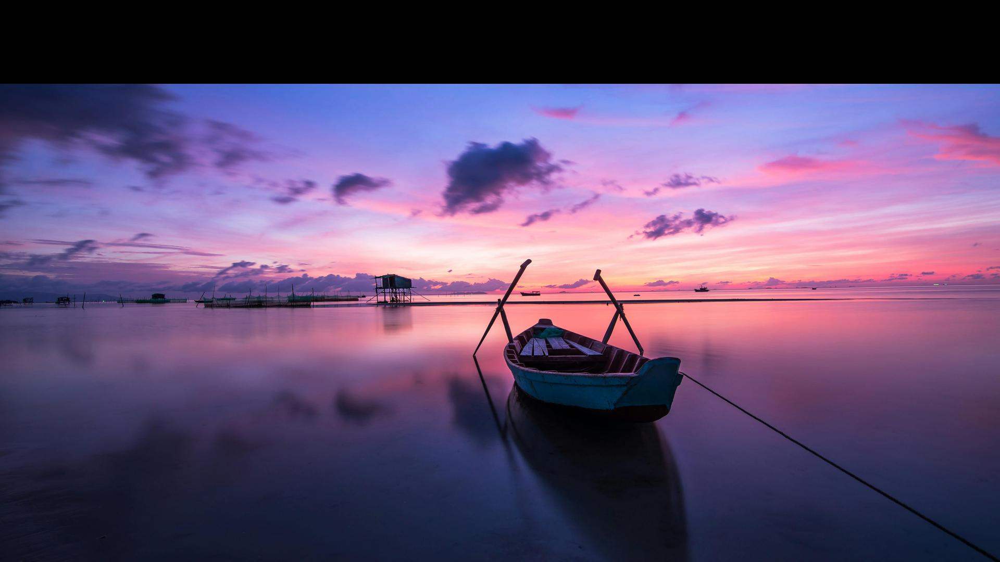

Final video not found: C:\Users\flyre\mynotebooks\final_那年夏天.mp4
Exported metadata for YouTube upload: C:\Users\flyre\mynotebooks\20251101_那年夏天\youtube_metadata.txt
專案名稱: 那年夏天
Current subdir: C:\Users\flyre\mynotebooks\20251101_那年夏天
目前工作目錄：C:\Users\flyre\mynotebooks


In [21]:
# cell 15
print("專案名稱:", config.get("project_title", config.get("title", "未設定")))
print("Current subdir:", subdir)
print("目前工作目錄：", os.getcwd())

from IPython.display import Video as ShowVideo, Image as ShowImage
import os
from datetime import datetime, timedelta

# --- Use consistent variables and paths ---
project_title = config.get('project_title', config.get('title', 'test'))
project_author = config.get('project_author', config.get('author', '未設定'))
attribution = config.get('attribution', '')
thumbnail_name = config.get('thumbnail', 'thumbnail.jpg')
thumbnail_path = os.path.join(subdir, thumbnail_name)

final_video_name = f"final_{project_title}.mp4"
outname_final = os.path.join(main_dir, final_video_name)

# --- Display thumbnail and final video ---
if os.path.exists(thumbnail_path):
    display(ShowImage(thumbnail_path))
else:
    print(f"Thumbnail not found: {thumbnail_path}")

if os.path.exists(outname_final):
    display(ShowVideo(url=outname_final))
else:
    print(f"Final video not found: {outname_final}")

# --- Export YouTube metadata ---
youtube_metadata_path = os.path.join(subdir, "youtube_metadata.txt")
subtitle_srt_path = os.path.join(subdir, "subtitle.srt")  # ASS to SRT conversion not shown, but path reserved
dt_utc_now = datetime.utcnow() + timedelta(hours=8)

with open(youtube_metadata_path, "w", encoding="utf-8") as meta:
    meta.write(f"Title: {project_title}\n")
    meta.write(f"Author: {project_author}\n")
    meta.write(f"Date: {dt_utc_now.strftime('%Y-%m-%d')}\n")
    meta.write(f"Description: {attribution}\n")
    meta.write(f"Subtitle SRT: {subtitle_srt_path}\n")
    meta.write(f"Thumbnail: {thumbnail_path}\n")

print(f"Exported metadata for YouTube upload: {youtube_metadata_path}")
print("="*40)
print(f"專案名稱: {project_title}")
print(f"Current subdir: {subdir}")
print(f"目前工作目錄：{os.getcwd()}")
print("="*40)

In [51]:
# cell 8.2

import os
import openai
from PIL import Image
from io import BytesIO
from IPython.display import display, Image as IPyImage, FileLink
import requests
from dotenv import load_dotenv

# 讀取 .env，取得 OPENAI_API
load_dotenv()
openai.api_key = os.getenv("OPENAI_API")

text_path = os.path.join(ammunition_dir, "text.txt")
with open(text_path, encoding="utf-8") as f:
    script_text = f.read().strip()

def auto_split_script(text, max_scene=4):
    lines = [l.strip() for l in text.split('\n') if l.strip()]
    n = min(max_scene, len(lines))
    if n == 1: return [text]
    chunk_len = len(lines) // n if len(lines) >= n else 1
    scenes = []
    for i in range(n):
        start = i * chunk_len
        end = (i+1) * chunk_len if i < n-1 else len(lines)
        scene = ' '.join(lines[start:end])
        if scene: scenes.append(scene)
    return scenes[:max_scene]

scenes = auto_split_script(script_text, max_scene=4)
print(f"自動分割為 {len(scenes)} 個場景。")

def make_prompt(scene, idx):
    return (
        f"Minimalist, modern, unique illustration for a YouTube thumbnail. "
        f"Scene {idx+1}: {scene}. Flat color, simple composition, high contrast. "
        f"1920x1080 ratio, striking and creative."
    )

prompts = [make_prompt(scene, i) for i, scene in enumerate(scenes)]

def dalle3_generate(prompt, idx, size="1792x1024"):  # 用 DALL·E 支援的最大橫幅
    print(f"呼叫DALL·E生成場景{idx+1}...")
    response = openai.images.generate(
        model="dall-e-3",
        prompt=prompt,
        size=size,         # 支援 '1024x1024', '1024x1792', '1792x1024'
        n=1,
        quality="standard"
    )
    url = response.data[0].url
    imgdata = requests.get(url).content
    img = Image.open(BytesIO(imgdata))
    # Resize 成 1920x1080
    img_resized = img.resize((1920, 1080), resample=Image.LANCZOS)
    fname = os.path.join(subdir, f"scene_{idx+1}.jpg")
    img_resized.save(fname, format="JPEG")
    display(IPyImage(data=BytesIO(img_resized.tobytes()).getvalue(), format='jpeg'))
    print(f"已儲存場景{idx+1}圖片：{fname}")
    return fname

scene_images = []
for idx, prompt in enumerate(prompts):
    print(f"場景{idx+1} prompt：{prompt}")
    fname = dalle3_generate(prompt, idx)
    scene_images.append(fname)

print("\n下載圖片：")
for fname in scene_images:
    display(FileLink(fname))

自動分割為 4 個場景。
場景1 prompt：Minimalist, modern, unique illustration for a YouTube thumbnail. Scene 1: 《燈光下的自己》. Flat color, simple composition, high contrast. 1920x1080 ratio, striking and creative.
呼叫DALL·E生成場景1...


已儲存場景1圖片：C:\Users\flyre\mynotebooks\20251101_燈光下的自己\scene_1.jpg
場景2 prompt：Minimalist, modern, unique illustration for a YouTube thumbnail. Scene 2: 夜深了，街上只剩幾盞昏黃的路燈。阿哲拖著疲憊的腳步走在回家的路上，手裡還拿著沒完成的報告。他心想：「也許我真的不適合這份工作。」. Flat color, simple composition, high contrast. 1920x1080 ratio, striking and creative.
呼叫DALL·E生成場景2...


已儲存場景2圖片：C:\Users\flyre\mynotebooks\20251101_燈光下的自己\scene_2.jpg
場景3 prompt：Minimalist, modern, unique illustration for a YouTube thumbnail. Scene 3: 就在這時，他看到一位清潔工正彎著腰，默默掃著落葉。那人看起來比他年長許多，卻沒有一絲怨言。路燈下，掃帚的聲音規律又穩定，像是在告訴他：「做事，只要一步一步來就好。」. Flat color, simple composition, high contrast. 1920x1080 ratio, striking and creative.
呼叫DALL·E生成場景3...


已儲存場景3圖片：C:\Users\flyre\mynotebooks\20251101_燈光下的自己\scene_3.jpg
場景4 prompt：Minimalist, modern, unique illustration for a YouTube thumbnail. Scene 4: 阿哲停下腳步，深吸了一口氣。他忽然明白，沒有人一開始就能做得完美。成功，不是因為比別人聰明，而是願意在黑夜裡繼續往前走。 回到家，他打開電腦，繼續修改那份報告。窗外的燈光透進來，映在螢幕上，他看見自己的影子。這一次，他對著影子微微一笑——那是一種重新出發的力量。. Flat color, simple composition, high contrast. 1920x1080 ratio, striking and creative.
呼叫DALL·E生成場景4...


已儲存場景4圖片：C:\Users\flyre\mynotebooks\20251101_燈光下的自己\scene_4.jpg

下載圖片：


C:\Users\flyre\mynotebooks\20251101_燈光下的自己\scene_1.jpg

C:\Users\flyre\mynotebooks\20251101_燈光下的自己\scene_2.jpg

C:\Users\flyre\mynotebooks\20251101_燈光下的自己\scene_3.jpg

C:\Users\flyre\mynotebooks\20251101_燈光下的自己\scene_4.jpg

In [20]:
import os
import azure.cognitiveservices.speech as speechsdk
from dotenv import load_dotenv

# 讀取 .env
load_dotenv()
AZURE_SPEECH_KEY = os.environ.get("AZURE_SPEECH_KEY")
AZURE_SPEECH_REGION = os.environ.get("AZURE_SPEECH_REGION")
VOICE = "zh-TW-YunJheNeural"
SPEED = 1.0
PITCH = 0

def azure_tts_api(text, voice, speed, pitch):
    speech_config = speechsdk.SpeechConfig(subscription=AZURE_SPEECH_KEY, region=AZURE_SPEECH_REGION)
    speech_config.speech_synthesis_voice_name = voice
    synthesizer = speechsdk.SpeechSynthesizer(speech_config=speech_config)
    result = synthesizer.speak_text_async(text).get()
    if result.reason == speechsdk.ResultReason.Canceled:
        cancellation_details = speechsdk.CancellationDetails(result)
        print(f"Azure TTS失敗: {cancellation_details.reason}\n{cancellation_details.error_details}")
        return None
    if result.reason == speechsdk.ResultReason.SynthesizingAudioCompleted:
        import tempfile
        tf = tempfile.NamedTemporaryFile(delete=False, suffix='.wav')
        tf.write(result.audio_data)
        tf.close()
        print(f"合成完成 (preview): {tf.name}")
        return tf.name
    else:
        print(f"Azure TTS失敗: {getattr(result, 'error_details', str(result.reason))}")
    return None

def azure_tts_to_file(text, voice, speed, pitch, filename):
    speech_config = speechsdk.SpeechConfig(subscription=AZURE_SPEECH_KEY, region=AZURE_SPEECH_REGION)
    speech_config.speech_synthesis_voice_name = voice
    speech_config.set_speech_synthesis_output_format(
        speechsdk.SpeechSynthesisOutputFormat.Audio16Khz32KBitRateMonoMp3
    )
    audio_config = speechsdk.audio.AudioOutputConfig(filename=filename)
    synthesizer = speechsdk.SpeechSynthesizer(speech_config=speech_config, audio_config=audio_config)
    ssml = f"""<speak version='1.0' xml:lang='zh-TW'>
      <voice name='{voice}'>
        <prosody rate='{speed}' pitch='{pitch}'>{text}</prosody>
      </voice>
    </speak>"""
    result = synthesizer.speak_ssml_async(ssml).get()
    if result.reason == speechsdk.ResultReason.SynthesizingAudioCompleted:
        print(f"[OK] 批次合成完成: {filename}")
        return True
    elif result.reason == speechsdk.ResultReason.Canceled:
        cancellation_details = speechsdk.CancellationDetails(result)
        print(f"[ERROR] 批次合成失敗: {filename}")
        print(f"Reason: {cancellation_details.reason}")
        print(f"Details: {cancellation_details.error_details}")
        print(f"SSML: {ssml}")
        return False
    else:
        print(f"[ERROR] TTS失敗(未知): {filename}, Reason: {result.reason}")
        return False

# ----------- 測試 preview (cell3) -----------
print("=== PREVIEW 測試 ===")
azure_tts_api("專案名稱為 test", VOICE, SPEED, PITCH)

# ----------- 批次合成 (cell4-8) -----------
print("=== 批次合成測試 ===")
sentences = [
    "專案名稱為 test",
    "請在專案開始前確認填寫正確名稱"
]
output_dir = "tts_batch_test"
os.makedirs(output_dir, exist_ok=True)

for idx, sentence in enumerate(sentences):
    fname = os.path.join(output_dir, f"voice_{idx}.mp3")
    azure_tts_to_file(sentence, VOICE, SPEED, PITCH, fname)

=== PREVIEW 測試 ===
合成完成 (preview): C:\Users\flyre\AppData\Local\Temp\tmpc8do0aaw.wav
=== 批次合成測試 ===


RuntimeError: Exception with error code: 
[CALL STACK BEGIN]

    > GetModuleObject
    - push_audio_input_stream_set_property_by_name
    - result_get_reason_canceled
    - ffi_prep_go_closure
    - ffi_call_go
    - ffi_call
    - 00007FFD2E8F3C05 (SymFromAddr() error: 企圖存取不正確的位址。)
    - 00007FFD2E8F2ACA (SymFromAddr() error: 企圖存取不正確的位址。)
    - 00007FFD2E8F26C8 (SymFromAddr() error: 企圖存取不正確的位址。)
    - PyObject_CallObject
    - PyEval_EvalFrameDefault
    - PyFunction_Vectorcall
    - PyObject_CallObject
    - PyEval_EvalFrameDefault
    - PyFunction_Vectorcall
    - PyUnicodeWriter_WriteSubstring

[CALL STACK END]

Exception with an error code: 0x5 (SPXERR_INVALID_ARG)

In [21]:
import os
import azure.cognitiveservices.speech as speechsdk
from dotenv import load_dotenv

load_dotenv()
AZURE_SPEECH_KEY = os.environ.get("AZURE_SPEECH_KEY")
AZURE_SPEECH_REGION = os.environ.get("AZURE_SPEECH_REGION")
VOICE = "zh-TW-YunJheNeural"

output_dir = "tts_batch_test"
os.makedirs(output_dir, exist_ok=True)

for idx, sentence in enumerate([
    "專案名稱為 test",
    "請在專案開始前確認填寫正確名稱"
]):
    speech_config = speechsdk.SpeechConfig(subscription=AZURE_SPEECH_KEY, region=AZURE_SPEECH_REGION)
    speech_config.speech_synthesis_voice_name = VOICE
    speech_config.set_speech_synthesis_output_format(
        speechsdk.SpeechSynthesisOutputFormat.Audio16Khz32KBitRateMonoMp3
    )
    fname = os.path.join(output_dir, f"voice_{idx}.mp3")
    audio_config = speechsdk.audio.AudioOutputConfig(filename=fname)
    synthesizer = speechsdk.SpeechSynthesizer(speech_config=speech_config, audio_config=audio_config)
    result = synthesizer.speak_text_async(sentence).get()
    if result.reason == speechsdk.ResultReason.SynthesizingAudioCompleted:
        print(f"[OK] 批次合成完成: {fname}")
    elif result.reason == speechsdk.ResultReason.Canceled:
        cancellation_details = speechsdk.CancellationDetails(result)
        print(f"[ERROR] 批次合成失敗: {sentence}")
        print(f"Reason: {cancellation_details.reason}")
        print(f"Details: {cancellation_details.error_details}")

[OK] 批次合成完成: tts_batch_test\voice_0.mp3
[OK] 批次合成完成: tts_batch_test\voice_1.mp3


In [22]:
import os
import requests
from dotenv import load_dotenv
import tempfile

# 讀取 .env
load_dotenv()
MINIMAX_SPEECH_KEY = os.environ.get("MINIMAX_SPEECH_KEY")

# 基本參數
MINIMAX_URL = "https://api.minimax.io/v1/t2a_v2?GroupId=1982992498867311582"
MODEL = "speech-02-hd"
VOICE = "Chinese (Mandarin)_Warm_Bestie"
EMOTION = "calm"
VOL = 1.0
SPEED = 1.0
PITCH = 0
AUDIO_FORMAT = "mp3"
SAMPLE_RATE = 32000
BITRATE = 128000
CHANNEL = 1

sentence = "專案名稱為 test"

headers = {
    "Authorization": f"Bearer {MINIMAX_SPEECH_KEY}",
    "Content-Type": "application/json"
}
payload = {
    "model": MODEL,
    "text": sentence,
    "voice_setting": {
        "voice_id": VOICE,
        "speed": SPEED,
        "vol": VOL,
        "pitch": PITCH,
        "emotion": EMOTION
    },
    "audio_setting": {
        "sample_rate": SAMPLE_RATE,
        "bitrate": BITRATE,
        "format": AUDIO_FORMAT,
        "channel": CHANNEL
    },
    "output_format": "url",
    "language_boost": "auto",
    "subtitle_enable": False
}

print("MINIMAX TTS測試 payload:")
print(payload)

r = requests.post(MINIMAX_URL, headers=headers, json=payload)
if r.status_code == 200:
    data = r.json()
    base_resp = data.get("base_resp", {})
    if base_resp.get("status_code") == 0:
        audio_url = data.get("data", {}).get("audio")
        print("音檔URL:", audio_url)
        if audio_url:
            r2 = requests.get(audio_url)
            if r2.status_code == 200:
                tf = tempfile.NamedTemporaryFile(delete=False, suffix="."+AUDIO_FORMAT)
                tf.write(r2.content)
                tf.close()
                print(f"MINIMAX TTS合成成功！檔案: {tf.name}")
            else:
                print("MINIMAX音檔下載失敗，狀態碼：", r2.status_code)
        else:
            print("MINIMAX未取得音檔URL，API回應：", data)
    else:
        print("MINIMAX API錯誤：", base_resp.get("status_msg", "未知"), "\nAPI回應：", data)
else:
    print("MINIMAX TTS API失敗，狀態碼：", r.status_code)
    print("回應：", r.text[:500])

MINIMAX TTS測試 payload:
{'model': 'speech-02-hd', 'text': '專案名稱為 test', 'voice_setting': {'voice_id': 'Chinese (Mandarin)_Warm_Bestie', 'speed': 1.0, 'vol': 1.0, 'pitch': 0, 'emotion': 'calm'}, 'audio_setting': {'sample_rate': 32000, 'bitrate': 128000, 'format': 'mp3', 'channel': 1}, 'output_format': 'url', 'language_boost': 'auto', 'subtitle_enable': False}
音檔URL: https://minimax-algeng-chat-tts-us.oss-us-east-1.aliyuncs.com/audio%2Ftts-20251101071236-iJKuTpssmlnteIhj.mp3?Expires=1762038757&OSSAccessKeyId=LTAI5tCpJNKCf5EkQHSuL9xg&Signature=Ms1DjmrS9Ddtopbop0CE%2BWSqICo%3D
MINIMAX TTS合成成功！檔案: C:\Users\flyre\AppData\Local\Temp\tmp4cnm0zy6.mp3
